In [3]:
import cv2 

import os

import matplotlib.pyplot as plt

In [4]:



def take_twenty_images():
    
    cap = cv2.VideoCapture(0)
    cap.set(cv2.CAP_PROP_FRAME_WIDTH, 1920)
    cap.set(cv2.CAP_PROP_FRAME_HEIGHT, 1080)
    for i in range(0, 50):
        cur_dir = os.getcwd()
        image_path = cur_dir 
        image_name = "image" + str(i) + ".jpg"
        ret, img = cap.read()
        cv2.imwrite(os.path.join(image_path, image_name), img)  # Change this to the path of your images
        
        
        plt.imshow(img)
        plt.show()

        input("enter when new position")
        
    



    
    

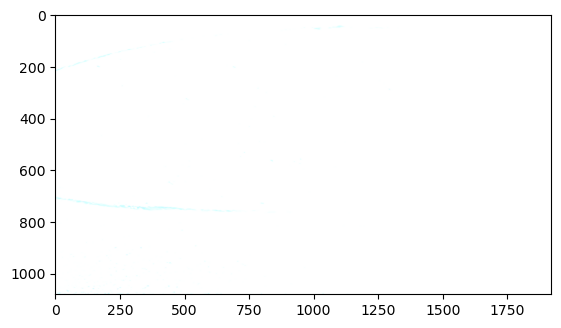

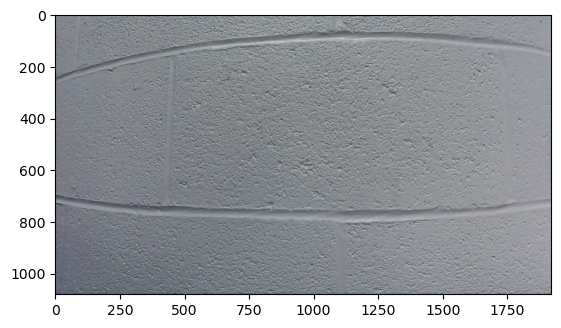

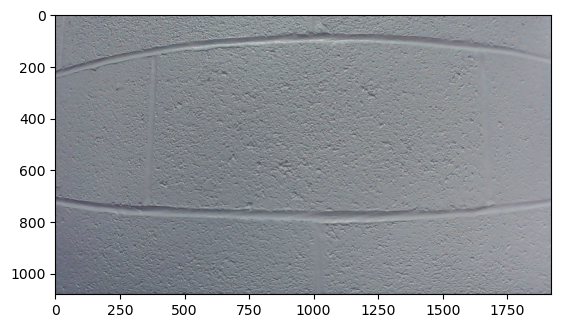

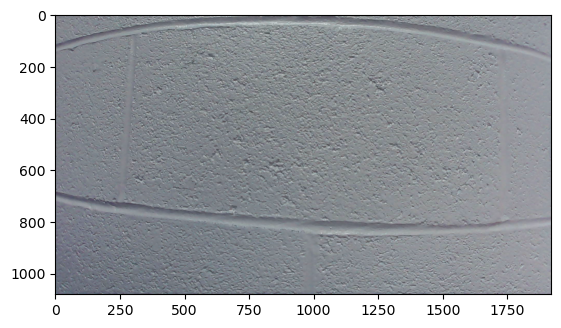

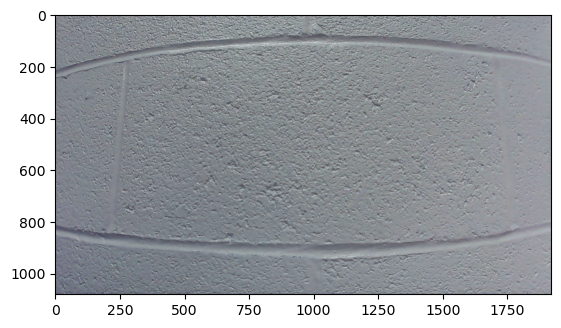

...

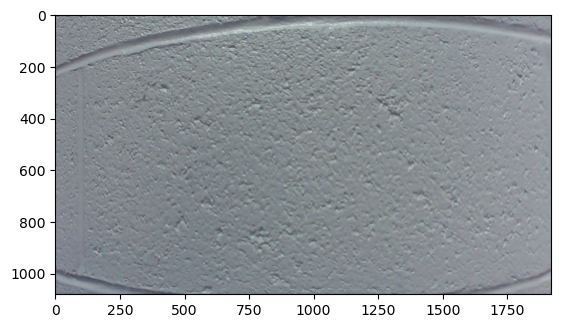

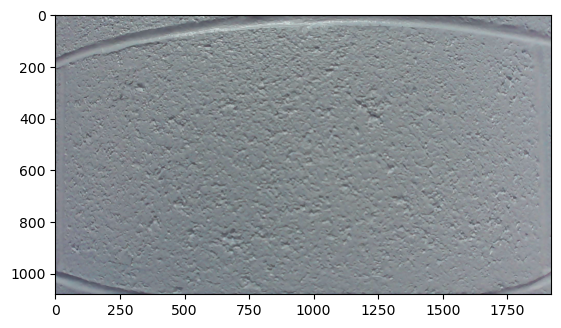

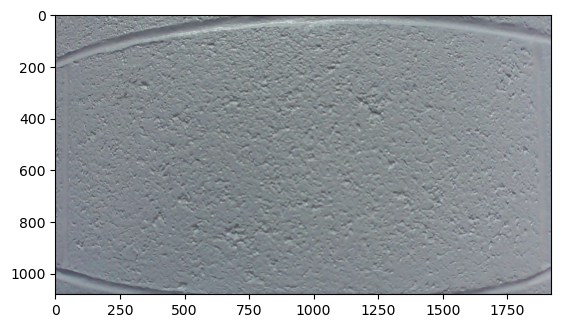

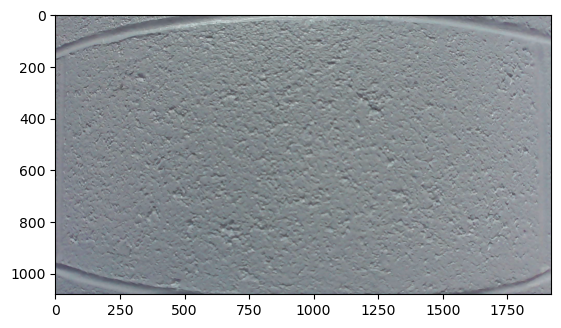

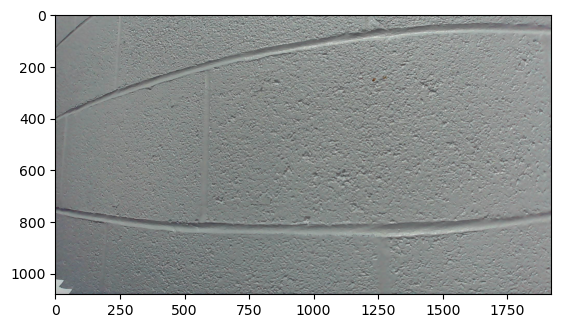

KeyboardInterrupt: Interrupted by user

In [5]:
take_twenty_images()

In [17]:
os.chdir(os.getcwd() + '/chessboard_shit')

/Users/zach/Desktop/SDP/SmokingDartsv3/images/chessboard_shit
['image48.jpg', 'image49.jpg', 'image8.jpg', 'image9.jpg', 'image14.jpg', 'image28.jpg', 'image29.jpg', 'image15.jpg', 'image17.jpg', 'image16.jpg', 'image_dartX.jpg', 'image12.jpg', 'image13.jpg', 'image39.jpg', 'image11.jpg', 'image10.jpg', 'image38.jpg', 'image21.jpg', 'image35.jpg', 'image34.jpg', 'image20.jpg', 'image36.jpg', 'image22.jpg', 'image23.jpg', 'image37.jpg', 'image33.jpg', 'image27.jpg', 'image26.jpg', 'image32.jpg', 'image18.jpg', 'image24.jpg', 'image30.jpg', 'image31.jpg', 'image25.jpg', 'image19.jpg', 'image7.jpg', 'image42.jpg', 'image43.jpg', 'image6.jpg', 'image4.jpg', 'image41.jpg', 'image40.jpg', 'image5.jpg', 'image1.jpg', 'image44.jpg', 'image45.jpg', 'image0.jpg', 'image2.jpg', 'image47.jpg', 'image46.jpg', 'image3.jpg']


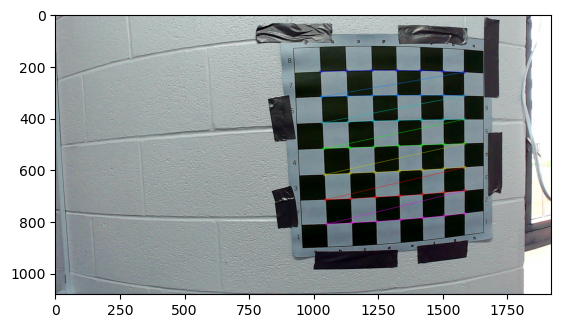

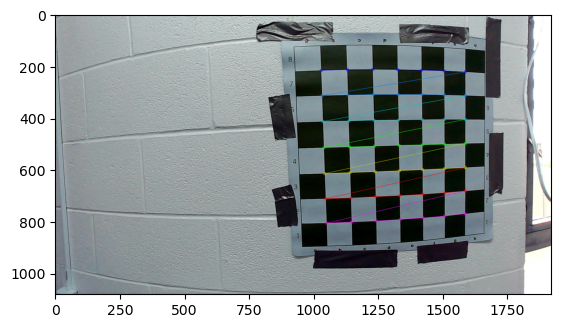

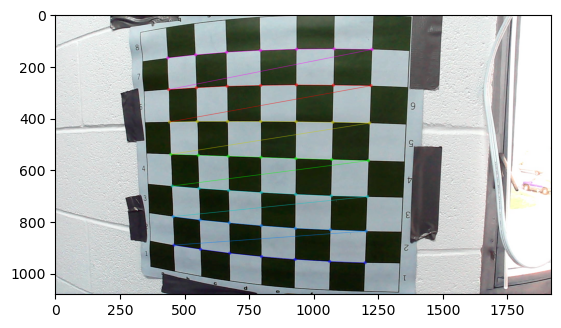

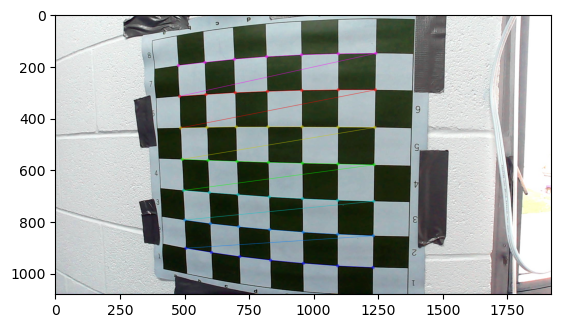

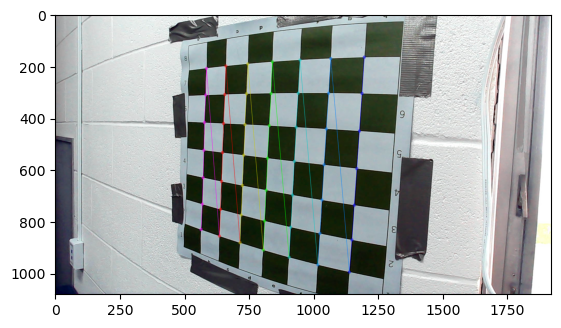

...

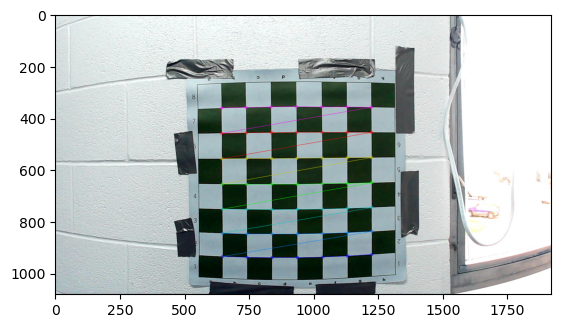

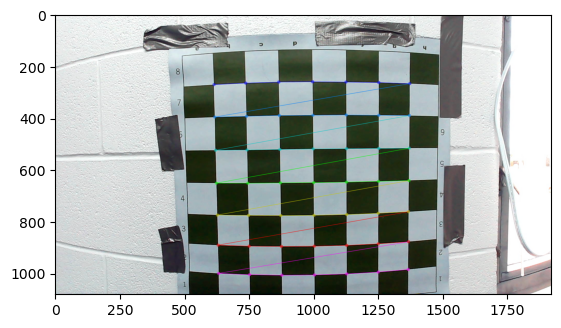

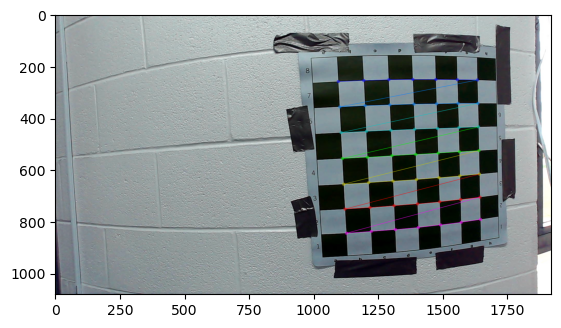

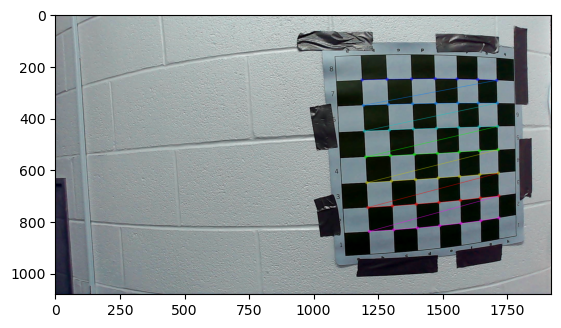

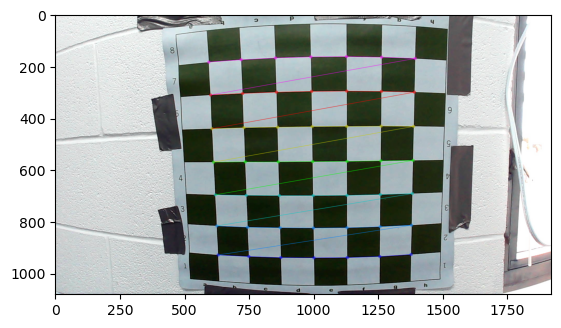

In [21]:
import numpy as np
import cv2 as cv
import glob

print(os.getcwd())
# termination criteria
criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 30, 0.001)
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((7*7,3), np.float32)
objp[:,:2] = np.mgrid[0:7,0:7].T.reshape(-1,2)
# Arrays to store object points and image points from all the images.
objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.
images = glob.glob('*.jpg')
print(images)
for fname in images:
    img = cv.imread(fname)
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    # Find the chess board corners
    ret, corners = cv.findChessboardCorners(gray, (7,7), None)
    # If found, add object points, image points (after refining them)
    if ret == True:
        objpoints.append(objp)
        corners2 = cv.cornerSubPix(gray,corners, (11,11), (-1,-1), criteria)
        imgpoints.append(corners2)
        # Draw and display the corners
        cv.drawChessboardCorners(img, (7,7), corners2, ret)
        cv.imshow('img', img)
        
        cv.waitKey(500)
cv.destroyAllWindows()

In [38]:
import math

ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, (1920, 1080), None, None)

print(dist)

k1 = dist[0][0]
k2 = dist[0][1]
k3 = dist[0][4]
p1 = dist[0][2]
p2 = dist[0][3]

print(mtx[0, 2])
print(mtx[1, 2])

xc = mtx[0, 2]
yc = mtx[1, 2]

xd = 960
yd = 540

r = math.sqrt((xd - xc)**2 + (yd - yc)**2)



#x = xd + (xd-xc)*(1 + k1*r**2 + k2*r**4 + k3*r**6) + 2*p2*(xd-xc)*(yd-yc) + p1*(r**2 + 2*(xd-xc)**2)

print(k1)

print(1 + k1*r**2 + k2*r**4 + k3*r**6)
#x = xd / (1 + k1*r**2 + k2*r**4 + k3*r**6)
print(x)

[[-2.39732479e-01  3.47974455e-02  4.12790767e-03  2.26039546e-04
   4.04325709e-03]]
986.0657631340378
566.9174803062725
-0.2397324789217524
11257718.433254052
8.527482772746087e-05


: 

In [23]:
img = cv2.imread('image1.jpg')
h,  w = img.shape[:2]
newcameramtx, roi = cv.getOptimalNewCameraMatrix(mtx, dist, (w,h), 1, (w,h))

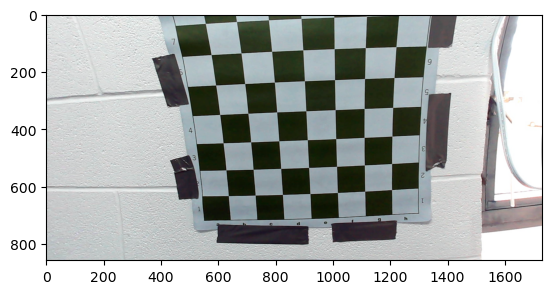

In [26]:
dst = cv2.undistort(img, mtx, dist, None, newcameramtx)
# crop the image
x, y, w, h = roi
dst = dst[y:y+h, x:x+w]

plt.imshow(dst)

In [25]:
mean_error = 0
for i in range(len(objpoints)):
    imgpoints2, _ = cv2.projectPoints(objpoints[i], rvecs[i], tvecs[i], mtx, dist)
    error = cv2.norm(imgpoints[i], imgpoints2, cv2.NORM_L2)/len(imgpoints2)
    mean_error += error
print( "total error: {}".format(mean_error/len(objpoints)) )

total error: 0.4035876545632766
